In [ ]:
!pip install osmnx
!pip install contextily
!pip install geodatasets

In [ ]:
%matplotlib inline

import contextily as cx
import geopandas as gpd
import rasterio
from rasterio.plot import show as rioshow
import matplotlib.pyplot as plt
from geodatasets import get_path

In [ ]:
import osmnx as ox
import folium

place = "Huangpu, Shanghai, China"
gdf = ox.geocoder.geocode_to_gdf(place)

In [ ]:
gdf

,geometry,bbox_west,bbox_south,bbox_east,bbox_north,place_id,osm_type,osm_id,lat,lon,class,type,place_rank,importance,addresstype,name,display_name
0,"POLYGON ((121.45221 31.22577, 121.45224 31.225...",121.452211,31.190191,121.505959,31.246306,208158205,relation,371650,31.233593,121.479864,boundary,administrative,12,0.52073,city,Huangpu District,"Huangpu District, Shanghai, China"


In [ ]:
!pip install folium matplotlib mapclassify
gdf.explore()

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.1/59.1 kB 3.5 MB/s eta 0:00:00


In [ ]:
huangpu_polygon = gdf.union_all()

In [ ]:
centroid = huangpu_polygon.centroid
m = folium.Map(location=[centroid.y, centroid.x], zoom_start=10)
folium.GeoJson(huangpu_polygon).add_to(m)
m

In [ ]:
buildings_gdf = ox.features_from_polygon(
    huangpu_polygon,
    tags = {
        "building": True,
        "highway": True
    }
)

In [ ]:
streets_graph = ox.graph_from_polygon(huangpu_polygon, network_type="all")
streets_gdf = ox.graph_to_gdfs(streets_graph, nodes=True)

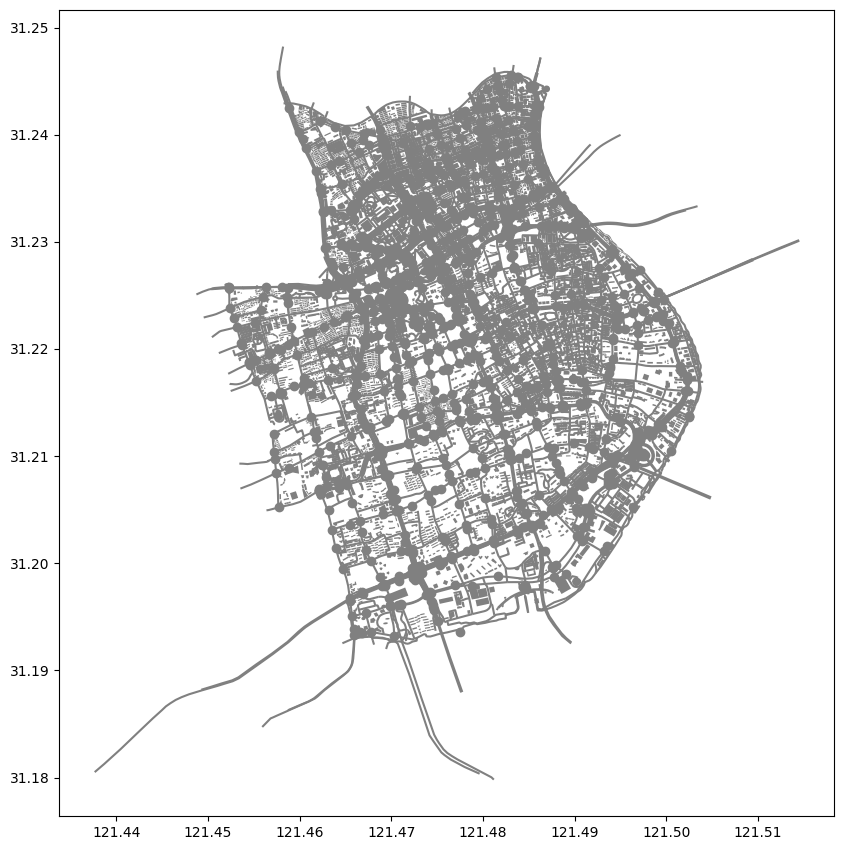

In [ ]:
ax = buildings_gdf.plot(figsize=(10, 15), color="gray")

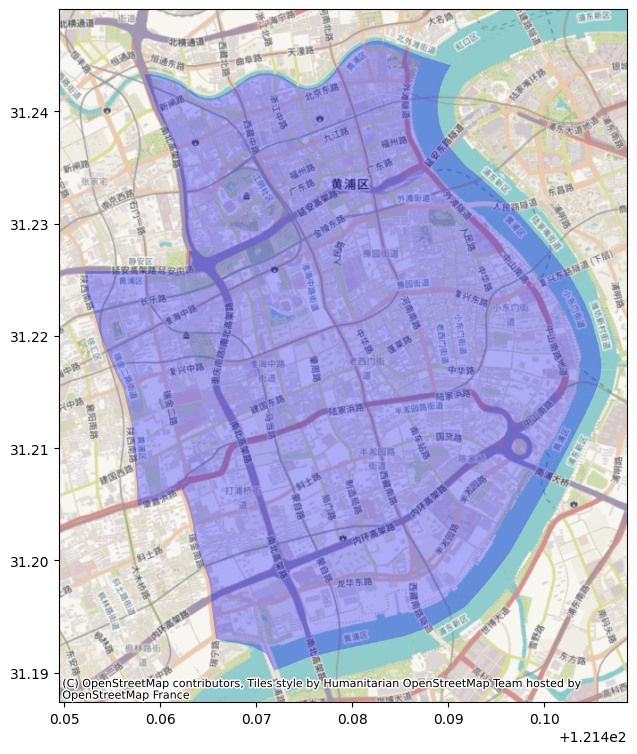

In [ ]:
ax = gdf.plot(color="blue", figsize=(9, 9), alpha=0.3)
cx.add_basemap(ax, crs=gdf.crs)

In [ ]:
poly = gdf.iloc[0, 0]

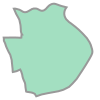

In [ ]:
poly

<Axes: >

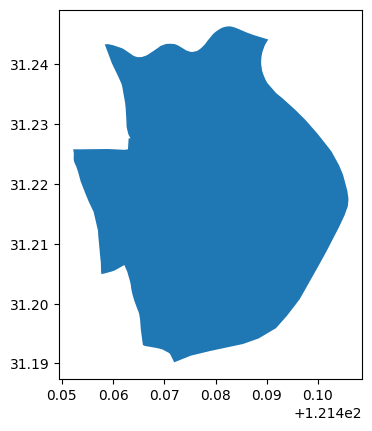

In [ ]:
gdf.plot()

In [ ]:
ox.geocode_to_gdf?

In [ ]:
tags_dict = {'tourism': 'museum'}
museum = ox.features_from_polygon(poly, tags=tags_dict)

<Axes: >

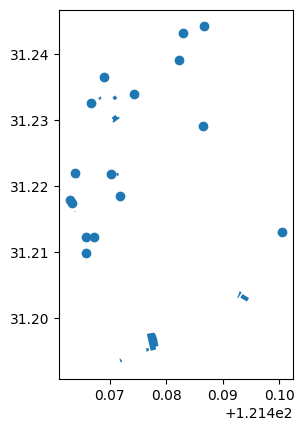

In [ ]:
museum.plot()

In [ ]:
museum.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
MultiIndex: 29 entries, ('node', np.int64(554246824)) to ('way', np.int64(985832362))
Data columns (total 48 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   geometry                29 non-null     geometry
 1   name                    25 non-null     object  
 2   tourism                 29 non-null     object  
 3   addr:city               4 non-null      object  
 4   addr:district           2 non-null      object  
 5   addr:housenumber        10 non-null     object  
 6   addr:street             10 non-null     object  
 7   contact:bilibili        2 non-null      object  
 8   contact:instagram       2 non-null      object  
 9   contact:youtube         2 non-null      object  
 10  email                   1 non-null      object  
 11  name:en                 21 non-null     object  
 12  name:zh                 15 non-null     object  
 13  opening_hours       

In [ ]:
# help(gpd.GeoDataFrame.estimate_utm_crs)

In [ ]:
utm_crs = gdf.estimate_utm_crs()
utm_crs

<Projected CRS: EPSG:32651>
Name: WGS 84 / UTM zone 51N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 120°E and 126°E, northern hemisphere between equator and 84°N, onshore and offshore. China. Indonesia. Japan. North Korea. Philippines. Russian Federation. South Korea. Taiwan.
- bounds: (120.0, 0.0, 126.0, 84.0)
Coordinate Operation:
- name: UTM zone 51N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
# museum["buffer"] = museum.to_crs(32651).buffer(800)

In [ ]:
map = museum.explore(tiles="cartodbdarkmatter")
museum.set_geometry('buffer').explore(
    m=map,
    color="cyan"
)
map

In [ ]:
buildings1_gdf = ox.features_from_polygon(huangpu_polygon,tags = {"building": True})

In [ ]:
buildings1_gdf.explore()

In [55]:
museum_utm = museum.to_crs(32651)
museum_utm["buffer"] = museum_utm.buffer(800)

museum_buffers = museum_utm.set_geometry("buffer")
buildings_utm = buildings1_gdf.to_crs(32651)

buildings_in_buffers = gpd.sjoin(
    buildings_utm,
    museum_buffers.reset_index(),
    how='inner',
    predicate='intersects',
    lsuffix='building',
    rsuffix='museum'
)

In [34]:
len(buildings_in_buffers)

20522

In [ ]:
m2 = buildings_utm.explore(color="navy", tiles="cartodbdarkmatter")
buildings_in_buffers.explore(m=m2, color="cyan")

In [41]:
# print(museum_buffers.crs)
# print(buildings_utm.crs)

EPSG:32651
EPSG:32651


In [49]:
buildings_in_buffers.head()

geometry  \
element_building id_building                                   
node             699811616    POINT (354940.019 3452057.599)   
                 699811616    POINT (354940.019 3452057.599)   
                 699811616    POINT (354940.019 3452057.599)   
                 1317213799   POINT (353117.406 3454996.372)   
                 1317213799   POINT (353117.406 3454996.372)   

                             building_building name_building name:zh_building  \
element_building id_building                                                    
node             699811616                 yes        L5轮渡码头           L5轮渡码头   
                 699811616                 yes        L5轮渡码头           L5轮渡码头   
                 699811616                 yes        L5轮渡码头           L5轮渡码头   
                 1317213799                yes    Citta Cafe              NaN   
                 1317213799                yes    Citta Cafe              NaN   

                             name:zh-Hans_building name:zh-Hant_building  \
element_building id_building                                               
node             699811616                  L5轮渡码头                L5輪渡碼頭   
                 699811616                  L5轮渡码头                L5輪渡碼頭   
                 699811616                  L5轮渡码头                L5輪渡碼頭   
                 1317213799                    NaN                   NaN   
                 1317213799                    NaN                   NaN   

                                                note amenity name:en_building  \
element_building id_building                                                    
node             699811616    disused ferry terminal     NaN              NaN   
                 699811616    disused ferry terminal     NaN              NaN   
                 699811616    disused ferry terminal     NaN              NaN   
                 1317213799                      NaN    cafe       Citta Cafe   
                 1317213799                      NaN    cafe       Citta Cafe   

                             building:levels_building  ...  \
element_building id_building                           ...   
node             699811616                        NaN  ...   
                 699811616                        NaN  ...   
                 699811616                        NaN  ...   
                 1317213799                       NaN  ...   
                 1317213799                       NaN  ...   

                             contact:phone_museum contact:tiktok_museum  \
element_building id_building                                              
node             699811616                    NaN                   NaN   
                 699811616                    NaN                   NaN   
                 699811616                    NaN                   NaN   
                 1317213799                   NaN                   NaN   
                 1317213799                   NaN                   NaN   

                             contact:twitter_museum contact:weibo_museum  \
element_building id_building                                               
node             699811616                      NaN                  NaN   
                 699811616                      NaN                  NaN   
                 699811616                      NaN                  NaN   
                 1317213799                     NaN                  NaN   
                 1317213799                     NaN                  NaN   

                             name:hi_museum name:pt_museum website:en_museum  \
element_building id_building                                                   
node             699811616              NaN            NaN               NaN   
                 699811616              NaN            NaN               NaN   
                 699811616              NaN            NaN               NaN   
                 1317213799             

In [57]:
building_counts = buildings_in_buffers.groupby("index_museum").size()
museum_buffers["building_count"] = museum_buffers.index.map(building_counts).fillna(0).astype(int)

In [59]:
print(buildings_in_buffers.columns)

Index(['geometry', 'building_building', 'name_building', 'name:zh_building',
       'name:zh-Hans_building', 'name:zh-Hant_building', 'note', 'amenity',
       'name:en_building', 'building:levels_building',
       ...
       'contact:phone_museum', 'contact:tiktok_museum',
       'contact:twitter_museum', 'contact:weibo_museum', 'name:hi_museum',
       'name:pt_museum', 'website:en_museum', 'name:es_museum',
       'addr:province_museum', 'name:ru_museum'],
      dtype='object', length=166)


In [58]:
museum_buffers[["name", "building_count"]]

name  building_count
element id                                                      
node    554246824                          第一美术馆               0
        3750123105                       上海外滩美术馆               0
        4674819096                     上海杜莎夫人蜡像馆               0
        4823869418               中国社会主义青年团中央机关旧址               0
        5042033123                      上海市文史研究馆               0
        5042033124                      上海市文史研究馆               0
        5053277922                     上海琉璃艺术博物馆               0
        5156435622                       外滩历史纪念馆               0
        5530017322                      上海市历史博物馆               0
        6358640818                           NaN               0
        6428524289                           NaN               0
        6886036509                     上海幻觉艺术博物馆               0
        6897158575                     屋裡廂石庫門博物館               0
        6917485861                     童涵春堂中药博物馆               0
        7005505230                   全融博物馆 银行博物馆               0
        12564905924                         春美术馆               0
way     39763847                       上海城市规划展示馆               0
        40324703                         上海当代艺术馆               0
        161090899                          上海博物馆               0
        206601791                            NaN               0
        298132744                      上海当代艺术博物馆               0
        372180467                         中共一大会址               0
        435452367                        中共一大纪念馆               0
        490656166                         世博会博物馆               0
        693448182                            NaN               0
        693448183                     《新青年》编辑部旧址               0
        745277155    teamLab Borderless Shanghai               0
        985832361                       中国乒乓球博物馆               0
        985832362                      卢湾城市规划展览馆               0

In [68]:
museum_buffers[["name", "building_count"]].sort_values(by = "building_count", ascending = False)

name  building_count
element id                                                      
node    554246824                          第一美术馆               0
        3750123105                       上海外滩美术馆               0
        4674819096                     上海杜莎夫人蜡像馆               0
        4823869418               中国社会主义青年团中央机关旧址               0
        5042033123                      上海市文史研究馆               0
        5042033124                      上海市文史研究馆               0
        5053277922                     上海琉璃艺术博物馆               0
        5156435622                       外滩历史纪念馆               0
        5530017322                      上海市历史博物馆               0
        6358640818                           NaN               0
        6428524289                           NaN               0
        6886036509                     上海幻觉艺术博物馆               0
        6897158575                     屋裡廂石庫門博物館               0
        6917485861                     童涵春堂中药博物馆               0
        7005505230                   全融博物馆 银行博物馆               0
        12564905924                         春美术馆               0
way     39763847                       上海城市规划展示馆               0
        40324703                         上海当代艺术馆               0
        161090899                          上海博物馆               0
        206601791                            NaN               0
        298132744                      上海当代艺术博物馆               0
        372180467                         中共一大会址               0
        435452367                        中共一大纪念馆               0
        490656166                         世博会博物馆               0
        693448182                            NaN               0
        693448183                     《新青年》编辑部旧址               0
        745277155    teamLab Borderless Shanghai               0
        985832361                       中国乒乓球博物馆               0
        985832362                      卢湾城市规划展览馆               0

In [65]:
museum_buffers.sort_values?